In [ ]:
! pip install py-ecg-detectors
! pip install neurokit2

In [ ]:
import pandas as pd
import numpy as np
import neurokit2 as nk
from ecgdetectors import Detectors
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

In [ ]:
df = pd.read_csv('/content/ecgpvc (1).dat', delimiter='\t',header = None)
df.columns = ['ECG_Signal']

In [ ]:
df

,ECG_Signal
0,2028.0
1,2029.0
2,2012.0
3,2016.0
4,2015.0
...,...
49995,1893.0
49996,1928.0
49997,1950.0
49998,1918.0


In [ ]:
ecg_signal = df['ECG_Signal'].values
ecg_signal

array([2028., 2029., 2012., ..., 1950., 1918., 1935.])

In [ ]:
print(len(ecg_signal))
print(max(ecg_signal))

50000
3641.0


In [ ]:
_, rpeaks = nk.ecg_peaks(ecg_signal, sampling_rate=200)

In [ ]:
rpeaks = rpeaks['ECG_R_Peaks']

In [ ]:
detectors = Detectors(200)
r_peaks = detectors.pan_tompkins_detector(ecg_signal)
print(r_peaks)

[71, 178, 310, 434, 551, 684, 806, 939, 1052, 1178, 1288, 1447, 1563, 1688, 1824, 1940, 2077, 2194, 2320, 2448, 2547, 2703, 2826, 2946, 3067, 3188, 3310, 3445, 3575, 3694, 3788, 3947, 4070, 4190, 4299, 4429, 4545, 4665, 4783, 4914, 5027, 5162, 5281, 5413, 5543, 5672, 5799, 5929, 6033, 6180, 6279, 6426, 6527, 6663, 6764, 6910, 7027, 7139, 7262, 7387, 7491, 7643, 7767, 7866, 8017, 8138, 8241, 8389, 8509, 8613, 8744, 8868, 8997, 9095, 9269, 9385, 9476, 9629, 9748, 9858, 9986, 10102, 10220, 10328, 10463, 10583, 10706, 10832, 10963, 11104, 11225, 11364, 11484, 11574, 11779, 11916, 12048, 12168, 12307, 12422, 12548, 12653, 12796, 12888, 13047, 13140, 13272, 13370, 13506, 13616, 13743, 13851, 13980, 14074, 14217, 14309, 14454, 14556, 14690, 14794, 14933, 15033, 15155, 15273, 15386, 15513, 15633, 15727, 15870, 15973, 16129, 16208, 16361, 16453, 16598, 16697, 16839, 16942, 17059, 17178, 17309, 17420, 17544, 17668, 17796, 17925, 18054, 18180, 18305, 18429, 18553, 18643, 18800, 18921, 19028, 1917

In [ ]:
rpeaks = np.insert(rpeaks, 0,55)

In [ ]:
len(rpeaks)

400

In [ ]:
fs = 200
RR = np.diff(rpeaks)/fs
RR = np.insert(RR,0,0.625)
print(RR)
len(RR)

[0.625 0.615 0.625 0.62  0.53  0.72  0.61  0.61  0.615 0.63  0.505 0.79
 0.635 0.62  0.63  0.63  0.635 0.64  0.63  0.64  0.45  0.825 0.615 0.6
 0.605 0.605 0.61  0.625 0.65  0.645 0.415 0.85  0.615 0.6   0.495 0.7
 0.58  0.6   0.59  0.6   0.62  0.625 0.645 0.66  0.65  0.645 0.57  0.715
 0.47  0.785 0.45  0.78  0.46  0.725 0.505 0.67  0.59  0.615 0.615 0.625
 0.47  0.81  0.62  0.45  0.8   0.605 0.465 0.74  0.595 0.58  0.65  0.62
 0.645 0.445 0.865 0.63  0.455 0.76  0.6   0.505 0.685 0.58  0.59  0.49
 0.72  0.6   0.62  0.63  0.65  0.66  0.655 0.645 0.65  0.445 0.98  0.685
 0.655 0.655 0.64  0.63  0.63  0.48  0.76  0.455 0.745 0.47  0.71  0.49
 0.68  0.505 0.68  0.49  0.695 0.47  0.715 0.46  0.725 0.46  0.715 0.475
 0.69  0.505 0.655 0.54  0.615 0.585 0.6   0.525 0.715 0.47  0.77  0.45
 0.765 0.46  0.725 0.495 0.655 0.57  0.58  0.6   0.6   0.61  0.62  0.615
 0.645 0.645 0.645 0.63  0.625 0.62  0.62  0.445 0.79  0.605 0.485 0.715
 0.595 0.6   0.48  0.735 0.605 0.615 0.625 0.64  0.475 0.81 

400

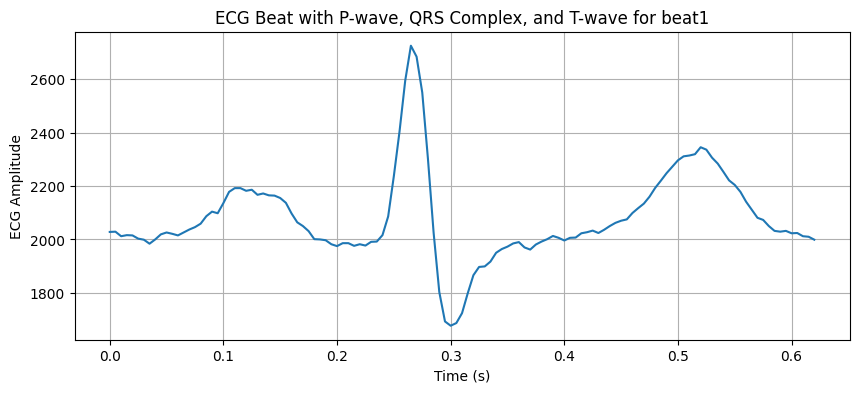

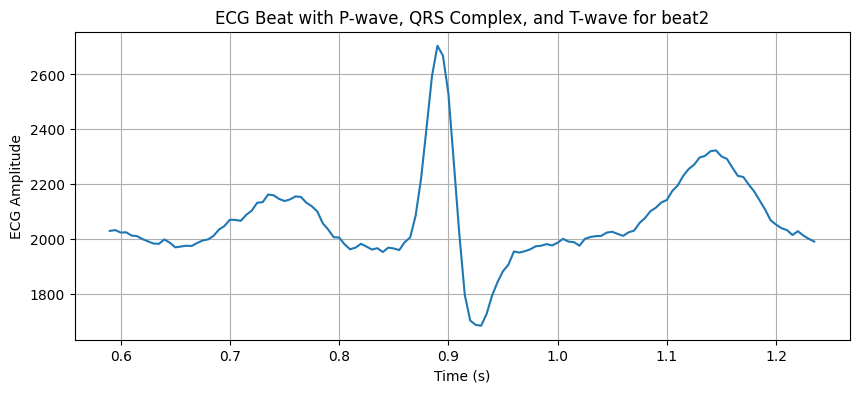

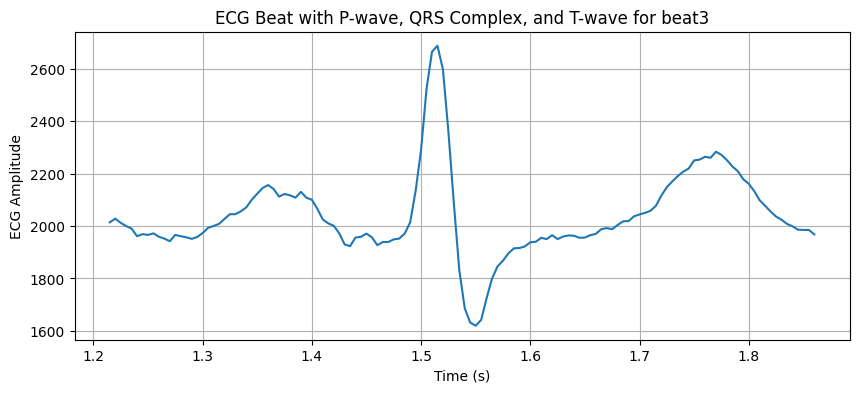

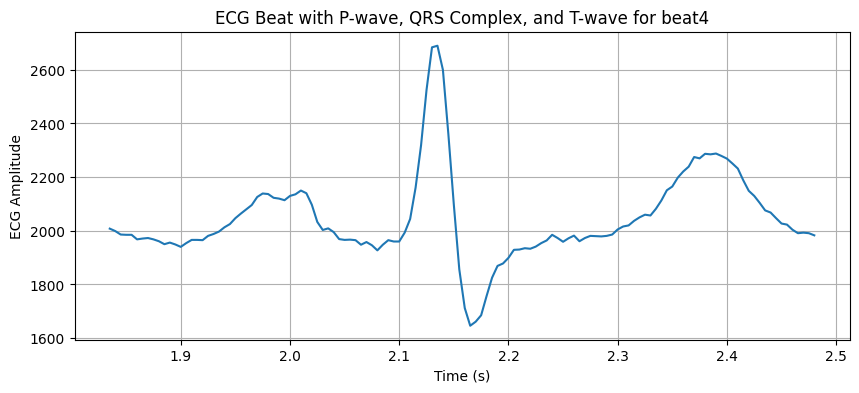

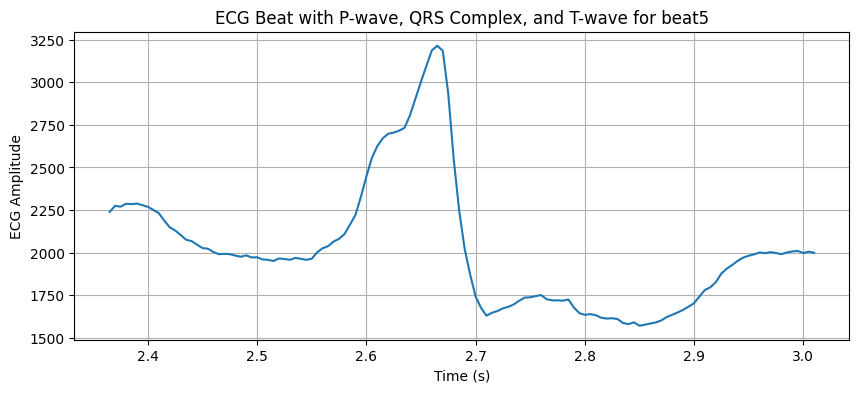

...

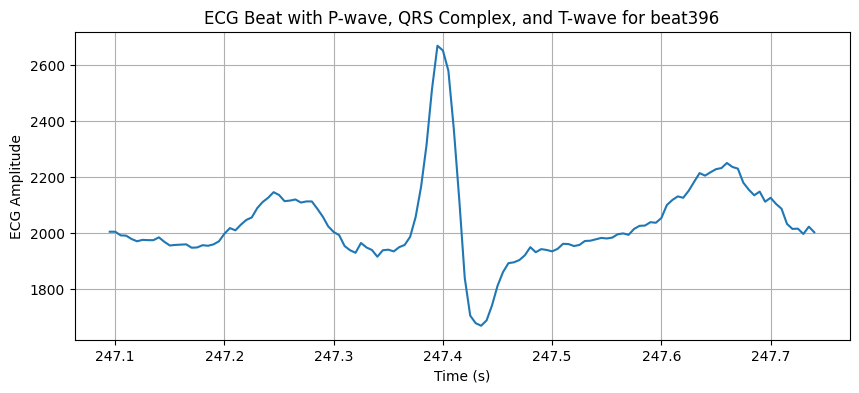

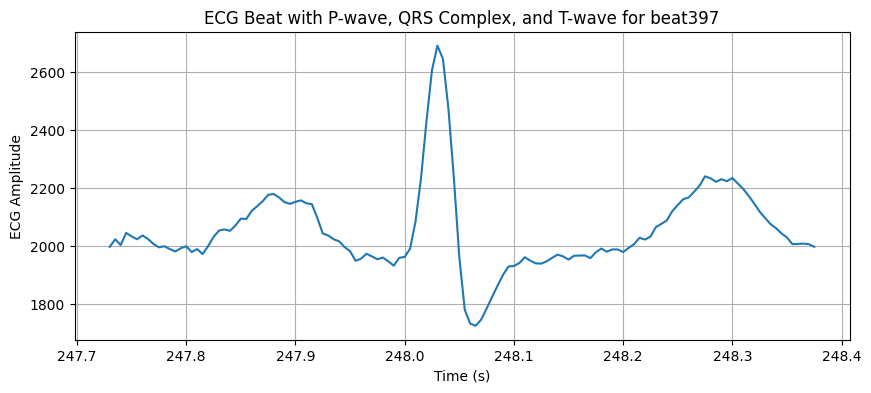

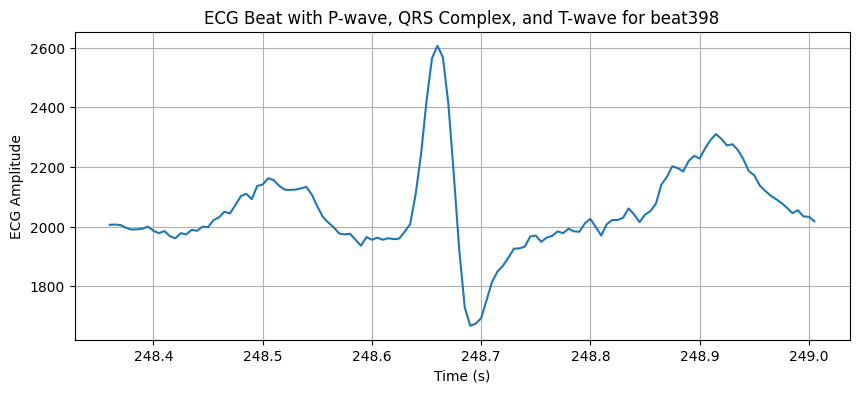

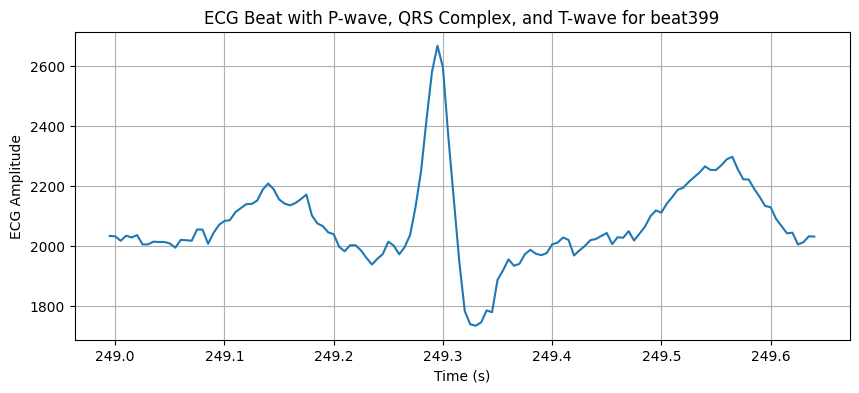

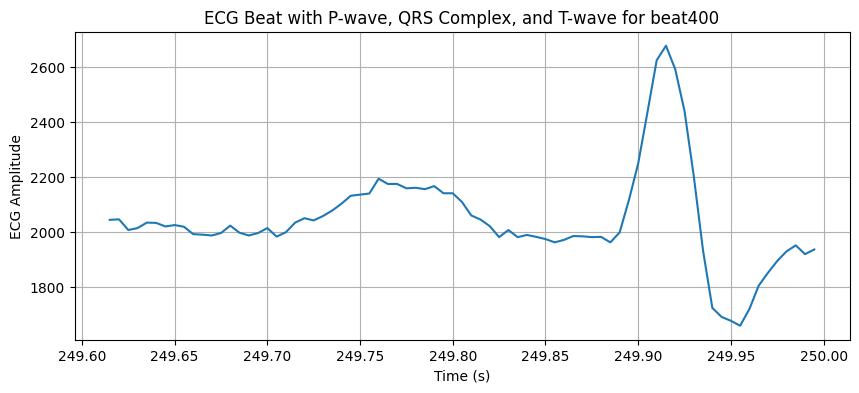

In [ ]:
fs = 200
duration_before_r_peak = 0.3
duration_after_r_peak = 0.35

i = 1
label = []
ff = []
for r_peak_index in rpeaks:

    start_index = max(0, r_peak_index - int(fs * duration_before_r_peak))
    end_index = min(len(ecg_signal), r_peak_index + int(fs * duration_after_r_peak))
    beat = ecg_signal[start_index:end_index]
    if max(beat)>=3000:
      label.append(1)
    else:
      label.append(0)
    first_derivative = np.diff(beat)
    second_derivative = np.diff(first_derivative)
    form_factor = (((np.std(second_derivative))*(np.std(beat)))/((np.std(first_derivative))*(np.std(first_derivative))))
    ff.append(form_factor)
    time_axis = np.arange(start_index, end_index) / fs

    plt.figure(figsize=(10, 4))
    plt.plot(time_axis, beat)
    plt.title(f'ECG Beat with P-wave, QRS Complex, and T-wave for beat{i}')
    plt.xlabel('Time (s)')
    plt.ylabel('ECG Amplitude')
    plt.grid(True)
    plt.show()
    i = i + 1


In [ ]:
print(label)

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

In [ ]:
count_pvc = 0
for i in label:
  if i ==1:
    count_pvc = count_pvc + 1
print(count_pvc)

88


In [ ]:
df = pd.DataFrame({'RR interval': RR, 'FF': ff})

In [ ]:
df

,RR interval,FF
0,0.625,1.690006
1,0.615,1.735436
2,0.625,1.722643
3,0.620,1.725158
4,0.530,3.001751
...,...,...
395,0.620,1.891013
396,0.635,1.752116
397,0.630,1.952996
398,0.635,2.175714


In [ ]:
_, waves_peak = nk.ecg_delineate(ecg_signal, rpeaks, sampling_rate=200, method="peak")

In [ ]:
Q_peaks = waves_peak['ECG_Q_Peaks']
S_peaks = waves_peak['ECG_S_Peaks']

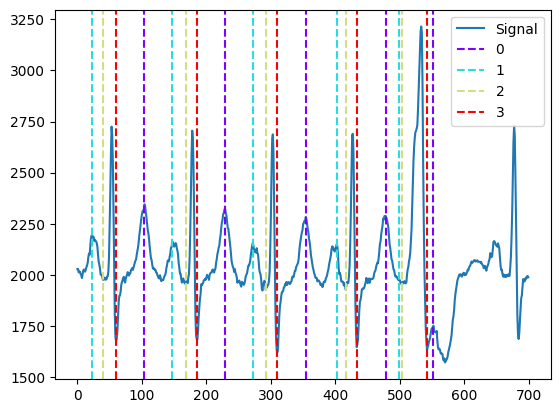

In [ ]:
plot = nk.events_plot([waves_peak['ECG_T_Peaks'][:5],
                       waves_peak['ECG_P_Peaks'][:5],
                       waves_peak['ECG_Q_Peaks'][:5],
                       waves_peak['ECG_S_Peaks'][:5]], ecg_signal[0:700])

In [ ]:
QRS_width = [(x - y)/200 for x, y in zip(S_peaks, Q_peaks)]
print(QRS_width)
QRS_width[399] = 18/200

[0.1, 0.09, 0.09, 0.085, 0.195, 0.095, 0.075, 0.085, 0.075, 0.095, 0.295, 0.095, 0.095, 0.09, 0.075, 0.075, 0.11, 0.09, 0.095, 0.085, 0.28, 0.09, 0.08, 0.085, 0.09, 0.105, 0.1, 0.075, 0.105, 0.095, 0.115, 0.09, 0.07, 0.105, 0.155, 0.115, 0.26, 0.08, 0.095, 0.075, 0.08, 0.085, 0.08, 0.085, 0.085, 0.07, nan, 0.095, 0.28, 0.11, 0.26, 0.08, 0.285, 0.07, 0.2, 0.09, 0.08, 0.09, 0.095, 0.085, 0.27, 0.09, 0.08, 0.28, 0.1, 0.1, 0.27, 0.085, 0.095, 0.16, 0.105, 0.085, 0.075, 0.16, 0.085, 0.105, 0.295, 0.085, 0.07, 0.17, 0.085, 0.08, 0.1, 0.08, 0.11, 0.08, 0.07, 0.085, 0.11, 0.1, 0.115, 0.1, 0.095, 0.15, 0.075, 0.1, 0.095, 0.085, 0.09, 0.085, 0.11, 0.26, 0.12, 0.27, 0.08, 0.27, 0.11, 0.18, 0.1, 0.17, 0.095, 0.16, 0.105, 0.14, 0.075, 0.26, 0.085, 0.275, 0.12, 0.16, 0.075, 0.08, 0.09, 0.23, 0.065, 0.075, 0.11, 0.205, 0.1, 0.275, 0.08, 0.235, 0.075, 0.28, 0.075, 0.19, 0.09, 0.07, 0.1, 0.1, 0.08, 0.1, 0.09, 0.075, 0.085, 0.08, 0.11, 0.105, 0.07, 0.075, 0.075, 0.155, 0.105, 0.075, 0.29, 0.105, 0.1, 0.

In [ ]:
df['QS width'] = QRS_width

In [ ]:
df['label'] = label

In [ ]:
df

,RR interval,FF,QS width,label
0,0.625,1.690006,0.100,0
1,0.615,1.735436,0.090,0
2,0.625,1.722643,0.090,0
3,0.620,1.725158,0.085,0
4,0.530,3.001751,0.195,1
...,...,...,...,...
395,0.620,1.891013,0.095,0
396,0.635,1.752116,0.075,0
397,0.630,1.952996,0.100,0
398,0.635,2.175714,0.070,0


In [ ]:
df.loc[46, 'QS width'] = 0.195

In [ ]:
df = df.dropna()
X = df.drop('label', axis=1)
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [ ]:
X_train['label'] = y_train

In [ ]:
X_train

,RR interval,FF,QS width,label
375,0.635,1.737264,0.115,0
208,0.475,3.382177,0.280,1
286,0.610,1.932755,0.100,0
168,0.630,3.348378,0.070,0
353,0.455,3.032370,0.285,1
...,...,...,...,...
71,0.620,1.870343,0.085,0
106,0.710,1.770050,0.110,0
270,0.935,1.960565,0.080,0
348,0.635,1.803690,0.070,0


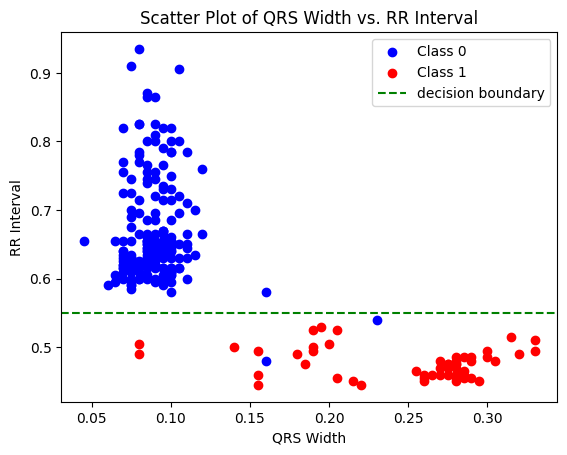

In [ ]:
class_0 = X_train[X_train['label'] == 0]
class_1 = X_train[X_train['label'] == 1]

plt.scatter(class_0['QS width'], class_0['RR interval'], c='blue', label='Class 0')
plt.scatter(class_1['QS width'], class_1['RR interval'], c='red', label='Class 1')

plt.axhline(y=0.55, color='green', linestyle='--', label='decision boundary')

plt.xlabel('QRS Width')
plt.ylabel('RR Interval')
plt.title('Scatter Plot of QRS Width vs. RR Interval')

plt.legend()

plt.show()

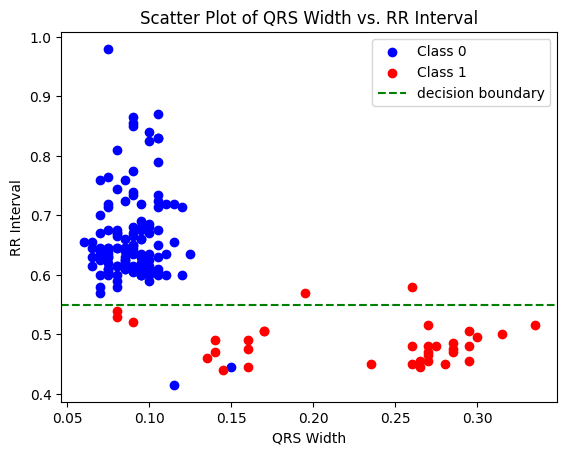

In [ ]:
X_test['label'] = y_test

class_0 = X_test[X_test['label'] == 0]
class_1 = X_test[X_test['label'] == 1]

plt.scatter(class_0['QS width'], class_0['RR interval'], c='blue', label='Class 0')
plt.scatter(class_1['QS width'], class_1['RR interval'], c='red', label='Class 1')

plt.axhline(y=0.55, color='green', linestyle='--', label='decision boundary')

plt.xlabel('QRS Width')
plt.ylabel('RR Interval')
plt.title('Scatter Plot of QRS Width vs. RR Interval')

plt.legend()

plt.show()

In [ ]:
class_counts = X_test['label'].value_counts()
print(class_counts)

0    125
1     35
Name: label, dtype: int64


In [ ]:
# True positive - 33
# False positive - 2
# False negative - 2
# True negative - 123
# TPF - 33/(33+2)
# FPF - 2/(2+123)

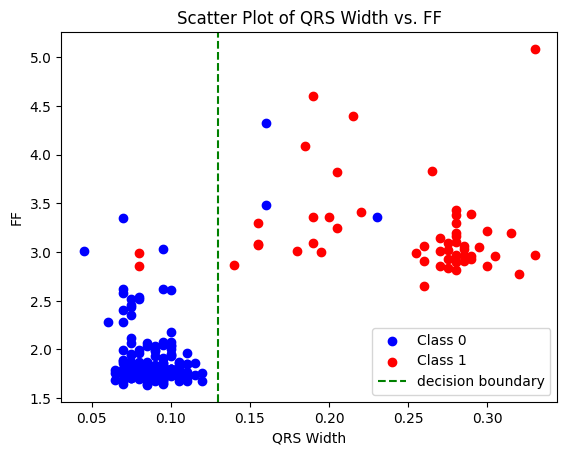

In [ ]:
class_0 = X_train[X_train['label'] == 0]
class_1 = X_train[X_train['label'] == 1]

plt.scatter(class_0['QS width'], class_0['FF'], c='blue', label='Class 0')
plt.scatter(class_1['QS width'], class_1['FF'], c='red', label='Class 1')

plt.axvline(x=0.13, color='green', linestyle='--', label='decision boundary')

plt.xlabel('QRS Width')
plt.ylabel('FF')
plt.title('Scatter Plot of QRS Width vs. FF')

plt.legend()

plt.show()

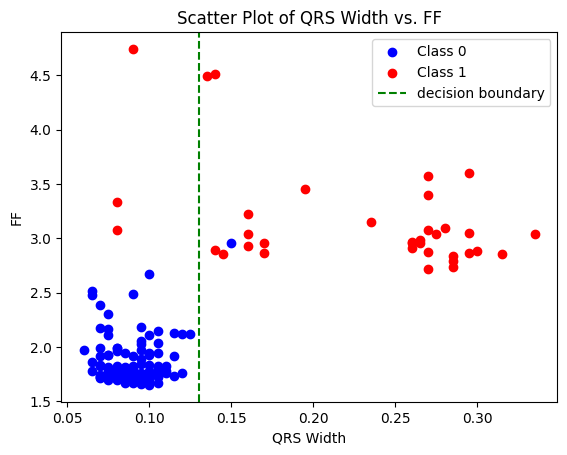

In [ ]:
class_0 = X_test[X_test['label'] == 0]
class_1 = X_test[X_test['label'] == 1]

plt.scatter(class_0['QS width'], class_0['FF'], c='blue', label='Class 0')
plt.scatter(class_1['QS width'], class_1['FF'], c='red', label='Class 1')

plt.axvline(x=0.13, color='green', linestyle='--', label='decision boundary')

plt.xlabel('QRS Width')
plt.ylabel('FF')
plt.title('Scatter Plot of QRS Width vs. FF')

plt.legend()

plt.show()


In [ ]:
# TP - 32
# FP - 1
# TN - 124
# FN - 3
# TPF - 32/(32+3)
# FPF - 1/(1+124)

In [ ]:
df = df.dropna()
X = df.drop('label', axis=1)
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [ ]:
X_train

,RR interval,FF,QS width
375,0.635,1.737264,0.115
208,0.475,3.382177,0.280
286,0.610,1.932755,0.100
168,0.630,3.348378,0.070
353,0.455,3.032370,0.285
...,...,...,...
71,0.620,1.870343,0.085
106,0.710,1.770050,0.110
270,0.935,1.960565,0.080
348,0.635,1.803690,0.070


In [ ]:
y_train

375    0
208    1
286    0
168    0
353    1
      ..
71     0
106    0
270    0
348    0
102    0
Name: label, Length: 240, dtype: int64

In [ ]:
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.98125


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.9875


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 5)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.99375


In [ ]:
knn = KNeighborsClassifier(n_neighbors=7)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.99375


In [ ]:
X_RR_QRS = df[['RR interval','QS width']]

In [ ]:
X_RR_QRS

,RR interval,QS width
0,0.625,0.100
1,0.615,0.090
2,0.625,0.090
3,0.620,0.085
4,0.530,0.195
...,...,...
395,0.620,0.095
396,0.635,0.075
397,0.630,0.100
398,0.635,0.070


In [ ]:
Y_RR_QRS = df['label']

In [ ]:
Y_RR_QRS

0      0
1      0
2      0
3      0
4      1
      ..
395    0
396    0
397    0
398    0
399    0
Name: label, Length: 400, dtype: int64

In [ ]:
X_train_RR_QRS, X_test_RR_QRS, y_train_RR_QRS, y_test_RR_QRS = train_test_split(X_RR_QRS, Y_RR_QRS, test_size=0.4, random_state=42)

In [ ]:
X_train_RR_QRS

,RR interval,QS width
375,0.635,0.115
208,0.475,0.280
286,0.610,0.100
168,0.630,0.070
353,0.455,0.285
...,...,...
71,0.620,0.085
106,0.710,0.110
270,0.935,0.080
348,0.635,0.070


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_train_RR_QRS, y_train_RR_QRS)
y_pred = knn.predict(X_test_RR_QRS)

accuracy = accuracy_score(y_test_RR_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.96875


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train_RR_QRS, y_train_RR_QRS)
y_pred = knn.predict(X_test_RR_QRS)

accuracy = accuracy_score(y_test_RR_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.98125


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 5)
knn.fit(X_train_RR_QRS, y_train_RR_QRS)
y_pred = knn.predict(X_test_RR_QRS)

accuracy = accuracy_score(y_test_RR_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.975


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 7)
knn.fit(X_train_RR_QRS, y_train_RR_QRS)
y_pred = knn.predict(X_test_RR_QRS)

accuracy = accuracy_score(y_test_RR_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.975


In [ ]:
X_FF_QRS = df[['FF','QS width']]
Y_FF_QRS = df['label']

In [ ]:
X_train_FF_QRS, X_test_FF_QRS, y_train_FF_QRS, y_test_FF_QRS = train_test_split(X_FF_QRS, Y_FF_QRS, test_size=0.4, random_state=42)

In [ ]:
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_train_FF_QRS, y_train_FF_QRS)
y_pred = knn.predict(X_test_FF_QRS)

accuracy = accuracy_score(y_test_FF_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.98125


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train_FF_QRS, y_train_FF_QRS)
y_pred = knn.predict(X_test_FF_QRS)

accuracy = accuracy_score(y_test_FF_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.99375


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 5)
knn.fit(X_train_FF_QRS, y_train_FF_QRS)
y_pred = knn.predict(X_test_FF_QRS)

accuracy = accuracy_score(y_test_FF_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.99375


In [ ]:
knn = KNeighborsClassifier(n_neighbors = 7)
knn.fit(X_train_FF_QRS, y_train_FF_QRS)
y_pred = knn.predict(X_test_FF_QRS)

accuracy = accuracy_score(y_test_FF_QRS, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.99375
